# Exploratory Data Analysis on Superheroes Dataset

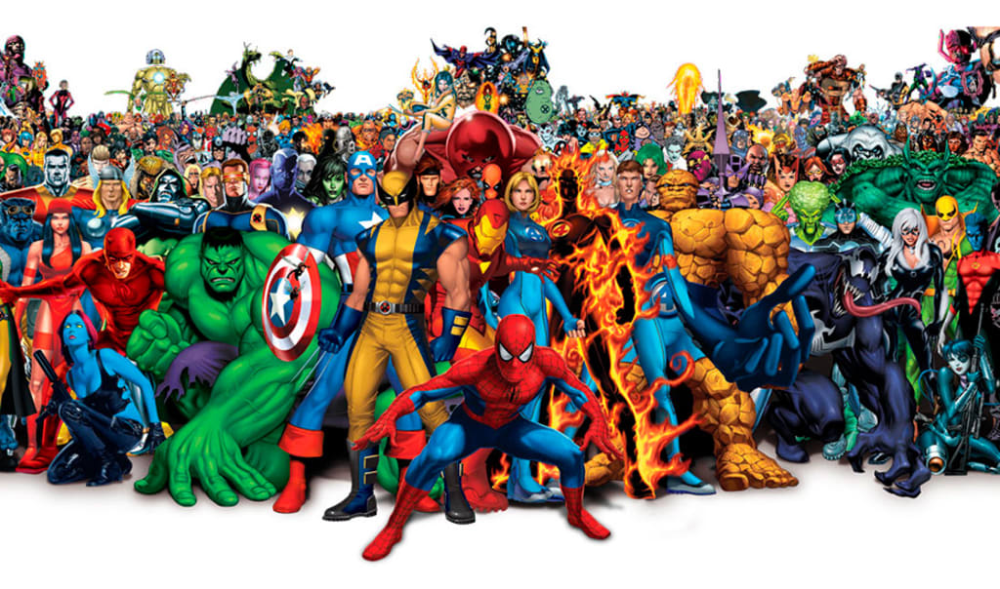

In [1]:
from wordcloud import WordCloud
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
pd.set_option('display.max_columns', None) # so that we can see all the columns
temp = pd.read_csv('D:\\Study\\EDA on Superheroes\\Cleaned_data\\cleaned_data_superheroes.csv')

sups = temp.copy()

## Top 5 rows from the dataset

In [3]:
sups.head()

,name,overall_score,intelligence_score,strength_score,speed_score,durability_score,power_score,combat_score,superpowers,alter_egos,aliases,place_of_birth,first_appearance,creator,alignment,occupation,base,teams,gender,type_race,height(cm),weight(lb),eye_color,hair_color,skin_color,has_electrokinesis,has_energy_constructs,has_mind_control_resistance,has_matter_manipulation,has_telepathy_resistance,has_mind_control,has_enhanced_hearing,has_dimensional_travel,has_element_control,has_size_changing,has_fire_resistance,has_fire_control,has_dexterity,has_reality_warping,has_illusions,has_energy_beams,has_peak_human_condition,has_shapeshifting,has_heat_resistance,has_jump,has_self-sustenance,has_energy_absorption,has_cold_resistance,has_magic,has_telekinesis,has_toxin_and_disease_resistance,has_telepathy,has_regeneration,has_immortality,has_teleportation,has_force_fields,has_energy_manipulation,has_endurance,has_longevity,has_weapon-based_powers,has_energy_blasts,has_enhanced_senses,has_invulnerability,has_stealth,has_marksmanship,has_flight,has_accelerated_healing,has_weapons_master,has_intelligence,has_reflexes,has_super_speed,has_durability,has_stamina,has_agility,has_super_strength
0,3-D Man,6,85,30,60,60,40,70,"['Super Speed', 'Super Strength']",[],[''],Unknown,Unknown,Marvel Comics,Good,Unknown,Unknown,"['Annihilators', 'Asgardians', 'Avengers', 'Ne...",Male,Human,183.14,209.93,Unknown,Unknown,Unknown,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,True
1,514A (Gotham),10,100,20,30,50,35,100,"['Durability', 'Reflexes', 'Super Strength']","['Batgod', 'Batman', 'Batman (1966)', 'Batman ...","['Subject 514A', 'Bruce Wayne', 'Bruce 2']",Unknown,Unknown,DC Comics,Unknown,Unknown,Unknown,[],Unknown,Unknown,183.14,209.93,Unknown,Unknown,Unknown,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,True,False,False,True
2,A-Bomb,20,80,100,80,100,100,80,"['Accelerated Healing', 'Agility', 'Berserk Mo...",[],['Rick Jones'],"Scarsdale, Arizona","Hulk Vol 2 #2 (April, 2008) (as A-Bomb)",Marvel Comics,Good,"Musician, adventurer, author; formerly talk sh...",Unknown,"['Teen Brigade', 'Ultimate Fantastic Four', 'U...",Male,Human,203.00,980.00,Yellow,No Hair,Unknown,False,False,False,False,True,False,False,False,False,True,True,False,False,False,False,False,False,True,True,True,True,False,True,False,False,True,False,True,False,False,False,False,True,True,False,False,True,True,True,False,False,True,False,False,True,True,True,True,True,True
3,Aa,12,80,50,55,45,100,55,"['Energy Absorption', 'Energy Armor', 'Energy ...",[],[''],Stoneworld,Green Lantern Vol 3 #21,DC Comics,Good,Unknown,Unknown,"['Blue Lantern Corps', 'Green Lantern Corps', ...",Male,Human,183.14,209.93,Unknown,Unknown,Unknown,False,True,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,True,False,False,False,False,False,False,False,False,True,True,False,False,True,True,False,False,False,False,False,False,False,False,False,False,False,False,False,False
4,Aaron Cash,5,80,10,25,40,30,50,"['Weapon-based Powers', 'Weapons Master']",[],[''],Gotham City,Unknown,DC Comics,Good,Unknown,Unknown,[],Male,Human,183.14,209.93,Unknown,Unknown,Unknown,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False


## What are the most common character names in the dataset?

In [4]:
from collections import defaultdict
import re

superhero_names = sups['name']

# Dictionary to store the frequency of common patterns
common_patterns_frequency = defaultdict(int)


def extract_common_pattern(name):
    # Remove parentheses and their contents
    name = re.sub(r'\([^)]*\)', '', name).strip()
    # Remove Roman numerals and additional symbols
    name = re.sub(r'(?:[IVXLCDM]+)(?![a-z])', '', name).strip()
    # Remove trailing spaces, hyphens, and numbers
    name = re.sub(r'[\s\-0-9]+$', '', name).strip()
    return name


for name in superhero_names:
    common_pattern = extract_common_pattern(name)
    common_patterns_frequency[common_pattern] += 1


sorted_patterns = sorted(common_patterns_frequency.items(), key=lambda x: x[1], reverse=True)


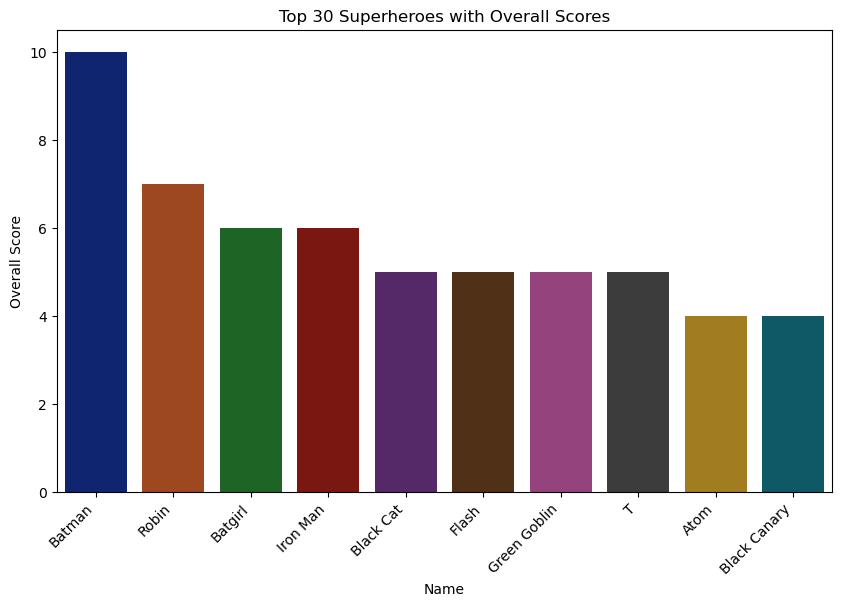

In [5]:
top_superheroes = [name for name, freq in sorted_patterns[:10]]
top_frequencies = [freq for name, freq in sorted_patterns[:10]]


# Horizontal bar chart
plt.figure(figsize=(10, 6))
sns.barplot(x=top_superheroes, y=top_frequencies, palette='dark')
plt.xlabel('Name')
plt.ylabel('Overall Score')
plt.title('Top 30 Superheroes with Overall Scores')
plt.xticks(rotation=45, ha='right')
plt.show()

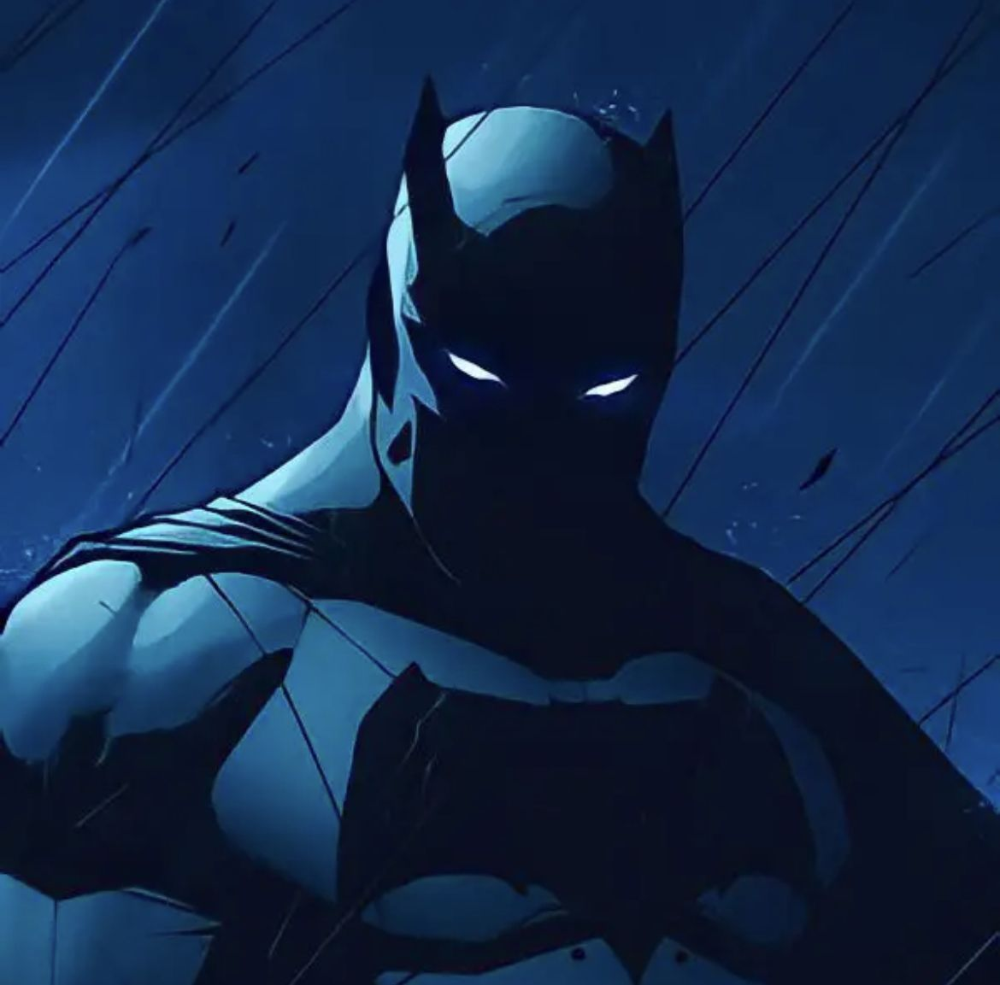

## Top 30 Superheroes with the most overall score

In [6]:
top_overall_score = sups.sort_values(by='overall_score',ascending=False)

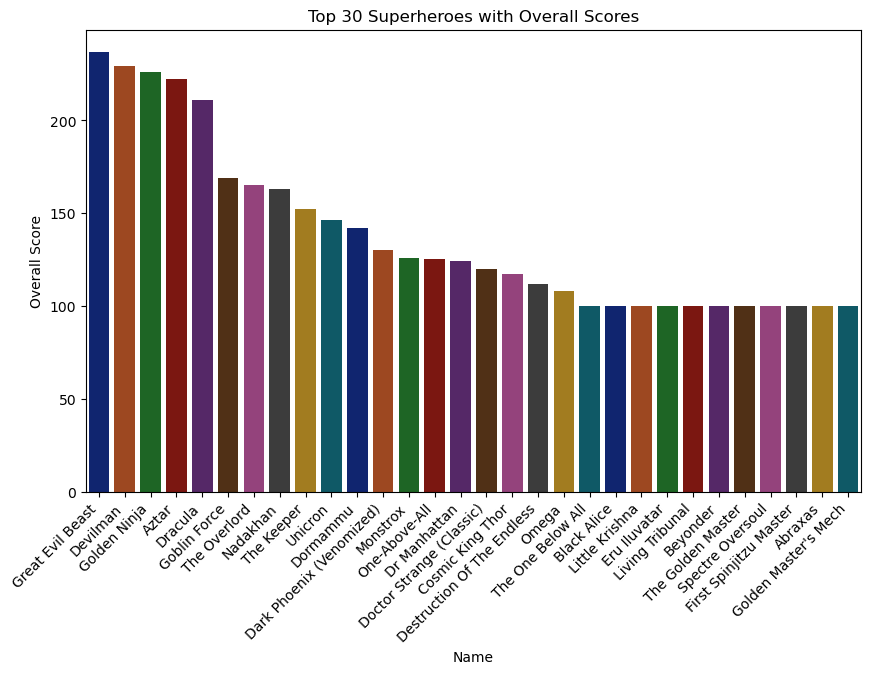

In [7]:
top_10 = top_overall_score[['name', 'overall_score']].head(30)

plt.figure(figsize=(10, 6))
sns.barplot(x='name', y='overall_score', data=top_10, palette='dark')
plt.xlabel('Name')
plt.ylabel('Overall Score')
plt.title('Top 30 Superheroes with Overall Scores')
plt.xticks(rotation=45, ha='right')
plt.show()


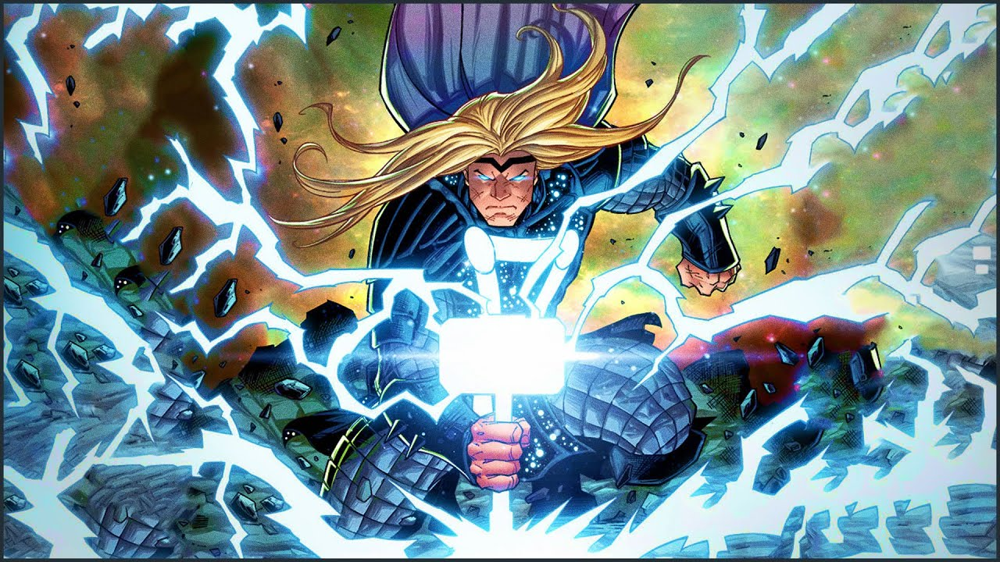

## Top 30 most intelligent superheroes

In [8]:
filtered_intelligence = sups[(sups['overall_score'] < sups['intelligence_score'])]


top_intelligence_score = filtered_intelligence.sort_values(by='intelligence_score', ascending=False)

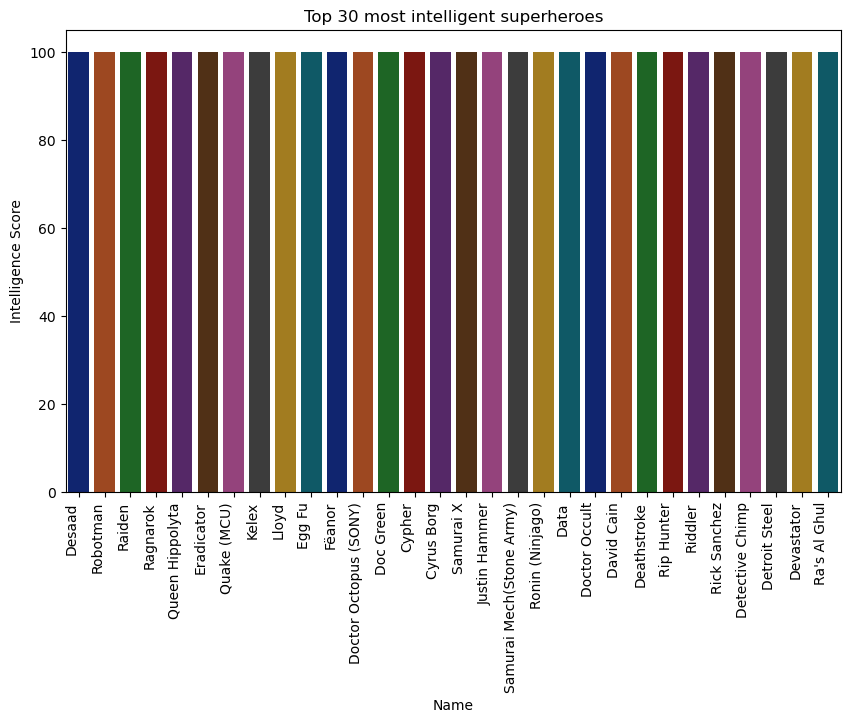

In [9]:
top_30 = top_intelligence_score[['name', 'intelligence_score']].head(30)
top_30 = top_30.sort_values(by='intelligence_score',ascending=False)

plt.figure(figsize=(10, 6))
sns.barplot(x='name', y='intelligence_score', data=top_30, palette='dark')
plt.xlabel('Name')
plt.ylabel('Intelligence Score')
plt.title('Top 30 most intelligent superheroes')
plt.xticks(rotation=90, ha='right')
plt.show()


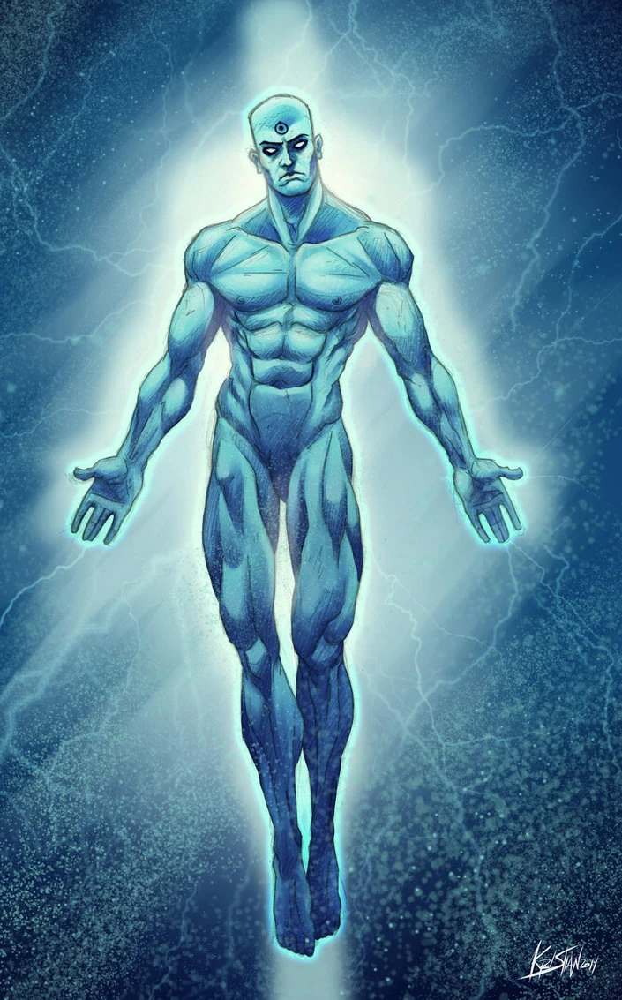

## Top 30 Strogest Superheroes

In [10]:
filtered_strength = sups[(sups['overall_score'] < sups['strength_score'])]


top_strength_score = filtered_strength.sort_values(by='strength_score', ascending=False)

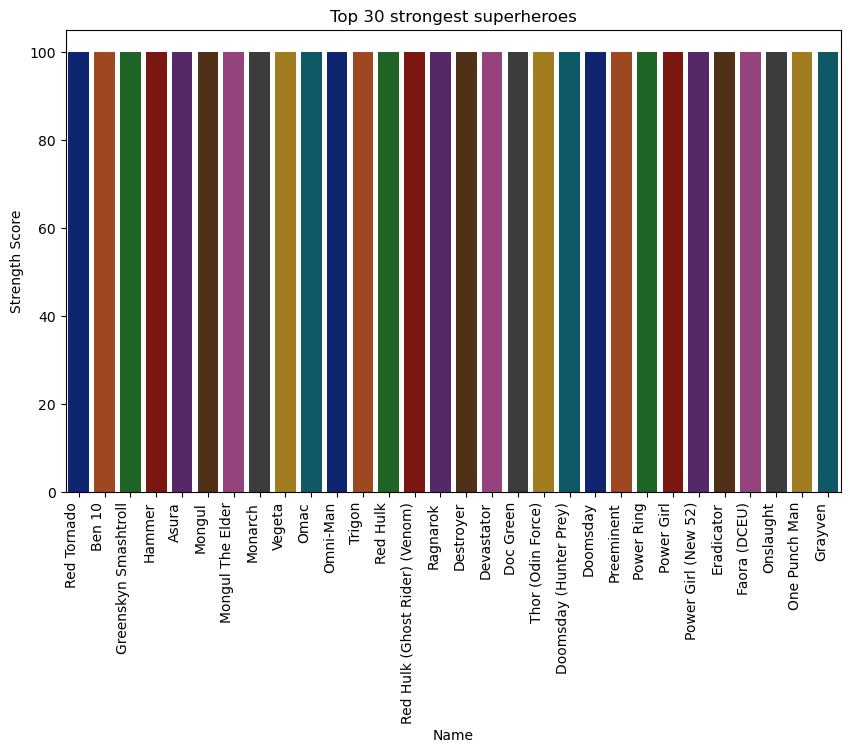

In [11]:
top_30 = top_strength_score[['name', 'strength_score']].head(30)
top_30 = top_30.sort_values(by='strength_score',ascending=False)

plt.figure(figsize=(10, 6))
sns.barplot(x='name', y='strength_score', data=top_30, palette='dark')
plt.xlabel('Name')
plt.ylabel('Strength Score')
plt.title('Top 30 strongest superheroes')
plt.xticks(rotation=90, ha='right')
plt.show()


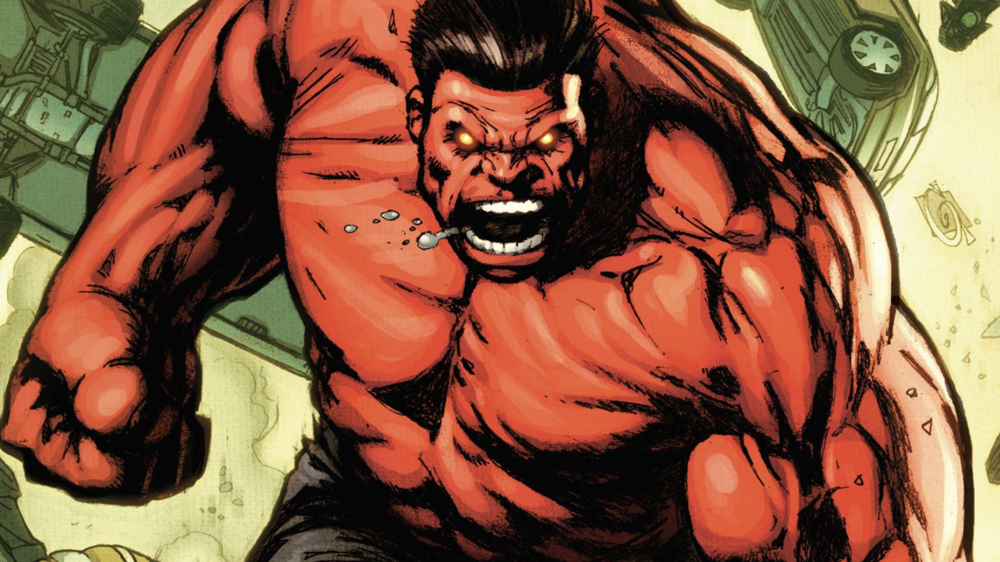

## Top 30 Speed Star

In [12]:
filtered_speed = sups[(sups['overall_score'] < sups['speed_score'])]


top_speed_score = filtered_speed.sort_values(by='speed_score', ascending=False)

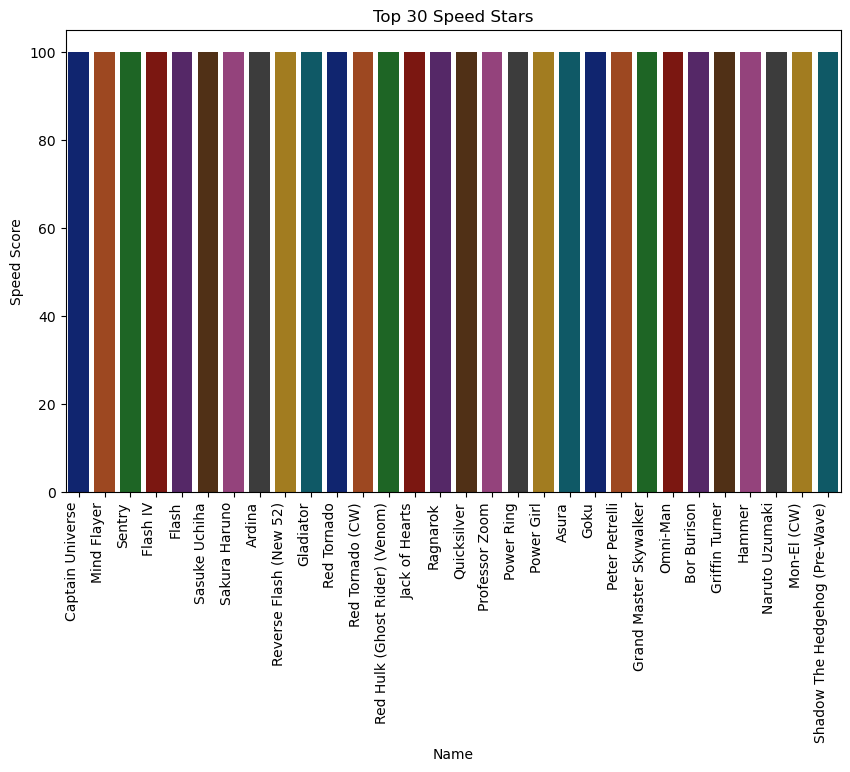

In [13]:
top_30 = top_speed_score[['name', 'speed_score']].head(30)
top_30 = top_30.sort_values(by='speed_score',ascending=False)

plt.figure(figsize=(10, 6))
sns.barplot(x='name', y='speed_score', data=top_30, palette='dark')
plt.xlabel('Name')
plt.ylabel('Speed Score')
plt.title('Top 30 Speed Stars')
plt.xticks(rotation=90, ha='right')
plt.show()


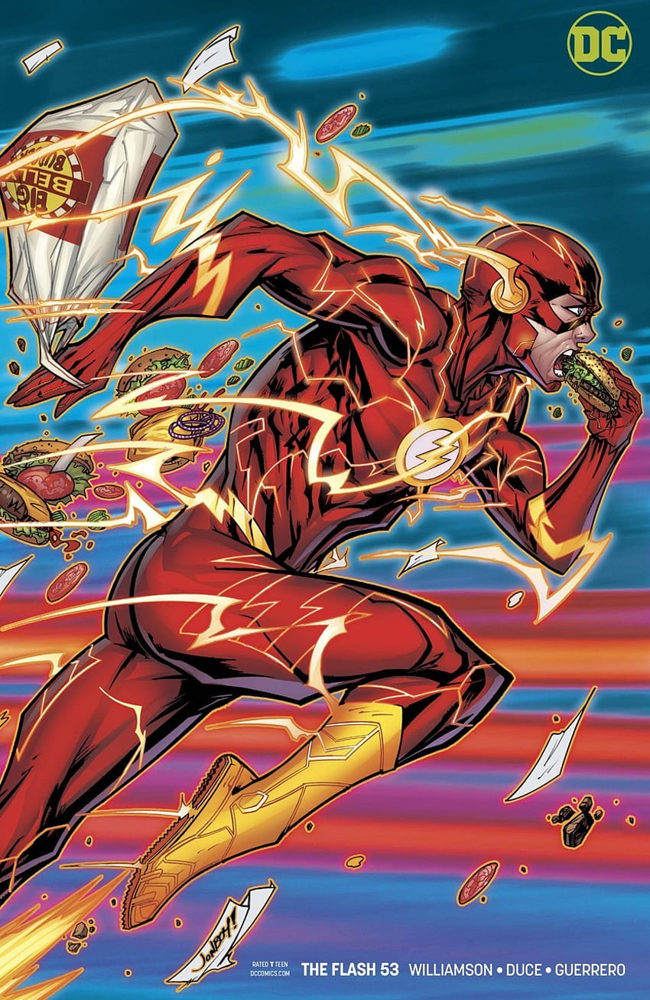

## Top 30 Most Durable Superheroes

In [14]:
filtered_durability = sups[(sups['overall_score'] < sups['durability_score'])]


top_durability_score = filtered_durability.sort_values(by='durability_score', ascending=False)

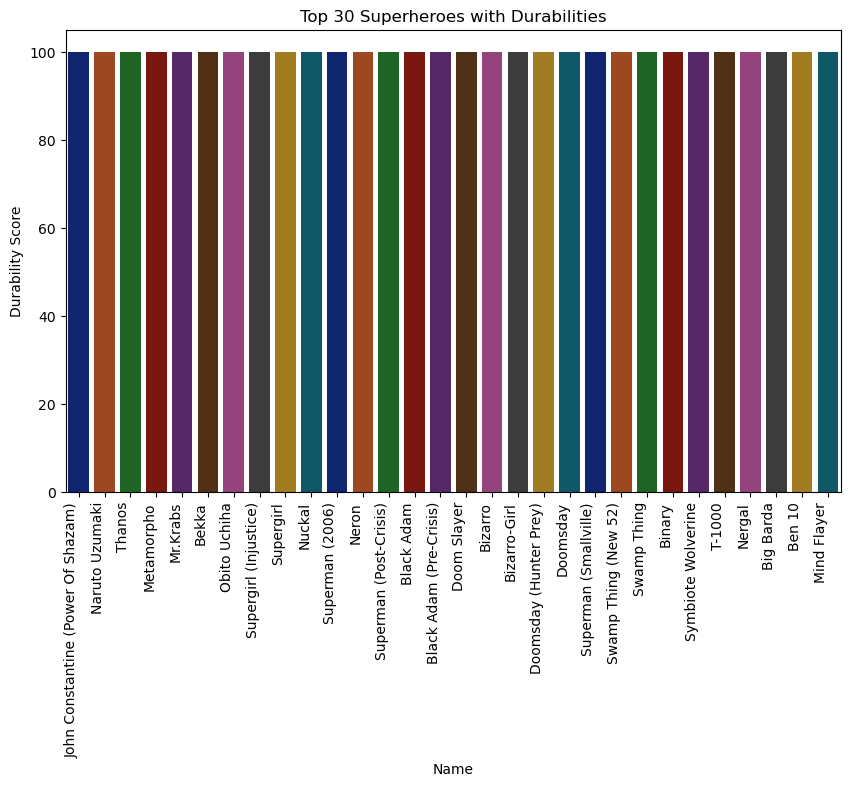

In [15]:
top_30 = top_durability_score[['name', 'durability_score']].head(30)
top_30 = top_30.sort_values(by='durability_score',ascending=False)

plt.figure(figsize=(10, 6))
sns.barplot(x='name', y='durability_score', data=top_30, palette='dark')
plt.xlabel('Name')
plt.ylabel('Durability Score')
plt.title('Top 30 Superheroes with Durabilities')
plt.xticks(rotation=90, ha='right')
plt.show()

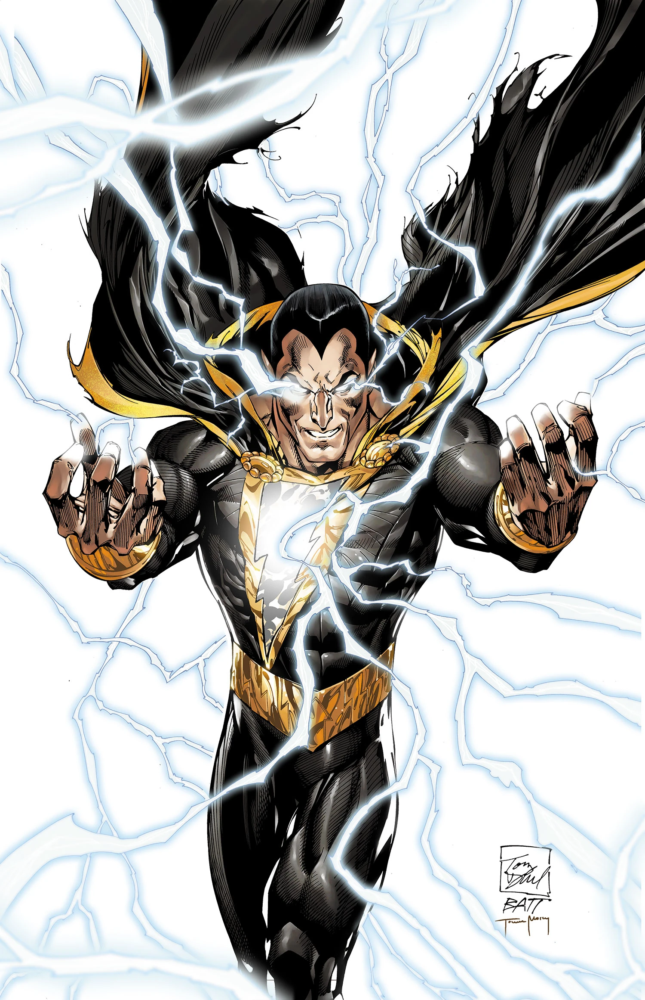

## Top 30 Most Powerful Superheroes

In [16]:
filtered_power = sups[(sups['overall_score'] < sups['power_score'])]


top_power_score = filtered_power.sort_values(by='power_score', ascending=False)

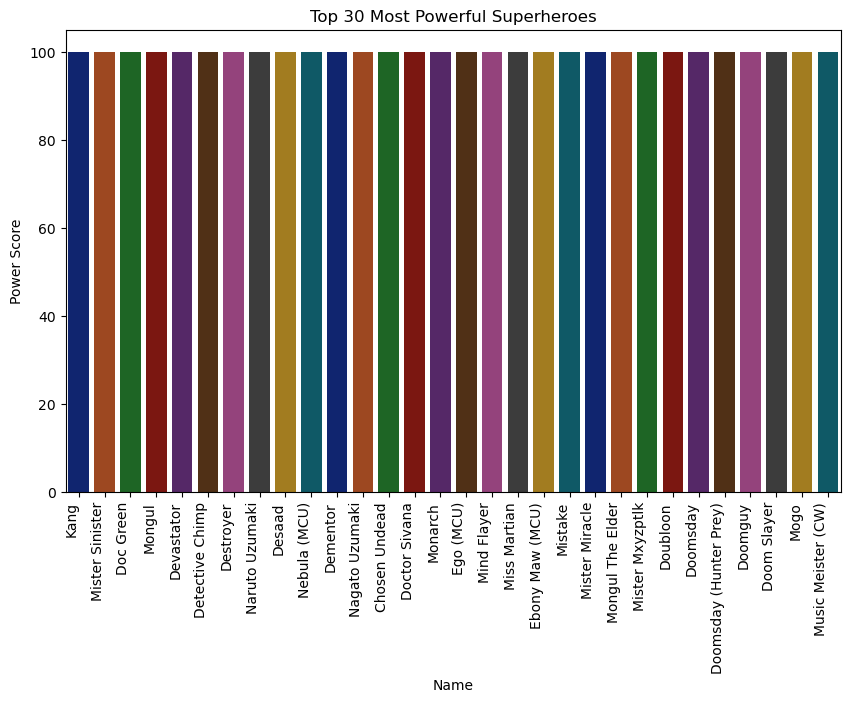

In [17]:
top_30 = top_power_score[['name', 'power_score']].head(30)
top_30 = top_30.sort_values(by='power_score',ascending=False)

plt.figure(figsize=(10, 6))
sns.barplot(x='name', y='power_score', data=top_30, palette='dark')
plt.xlabel('Name')
plt.ylabel('Power Score')
plt.title('Top 30 Most Powerful Superheroes')
plt.xticks(rotation=90, ha='right')
plt.show()

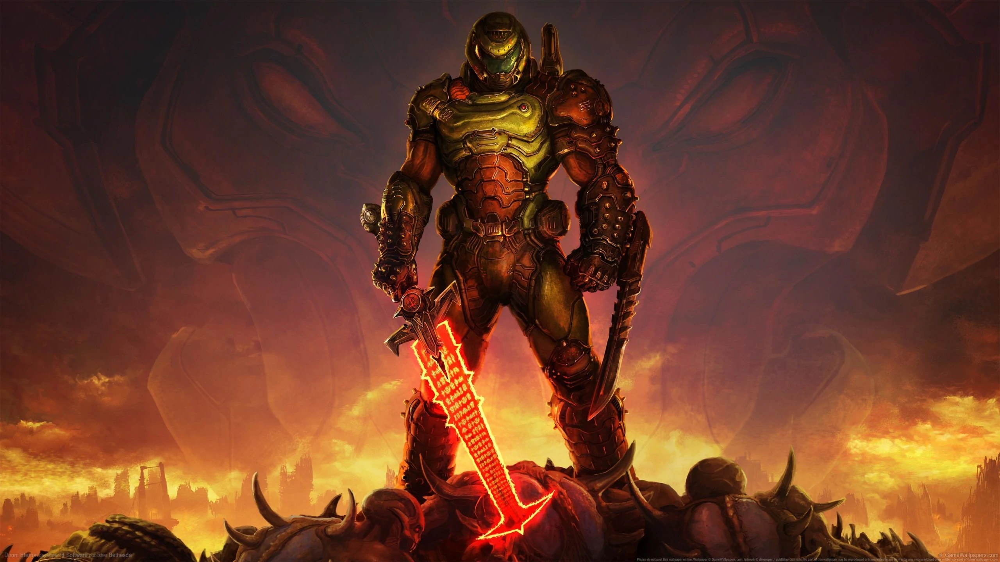

## Top 30 Superheroes in terms of Combat Score

In [18]:
filtered_combat = sups[(sups['overall_score'] < sups['combat_score'])]


top_combat_score = filtered_power.sort_values(by='combat_score', ascending=False)

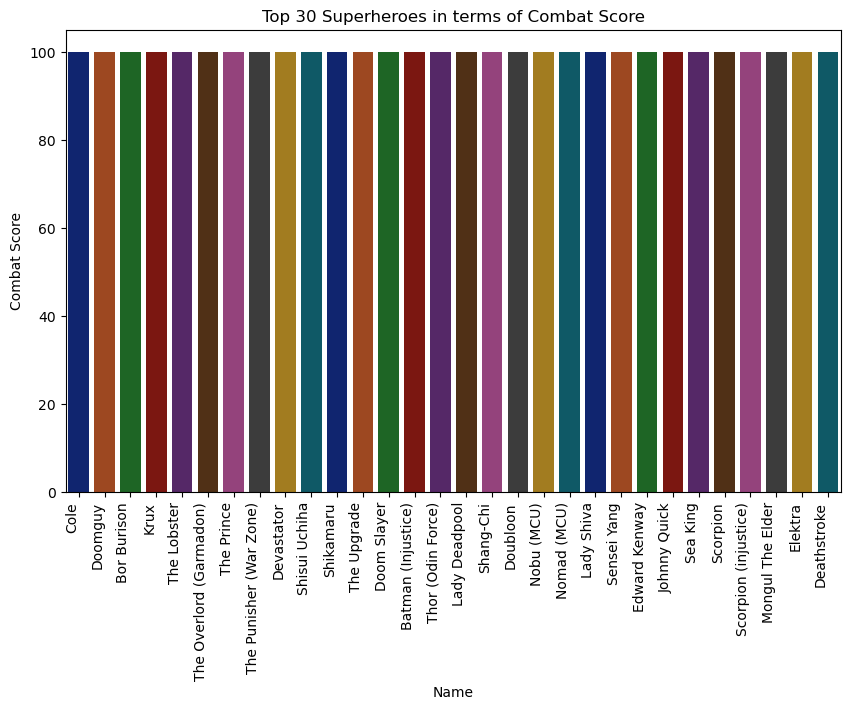

In [19]:
top_30 = top_combat_score[['name', 'combat_score']].head(30)
top_30 = top_30.sort_values(by='combat_score',ascending=False)

plt.figure(figsize=(10, 6))
sns.barplot(x='name', y='combat_score', data=top_30, palette='dark')
plt.xlabel('Name')
plt.ylabel('Combat Score')
plt.title('Top 30 Superheroes in terms of Combat Score')
plt.xticks(rotation=90, ha='right')
plt.show()

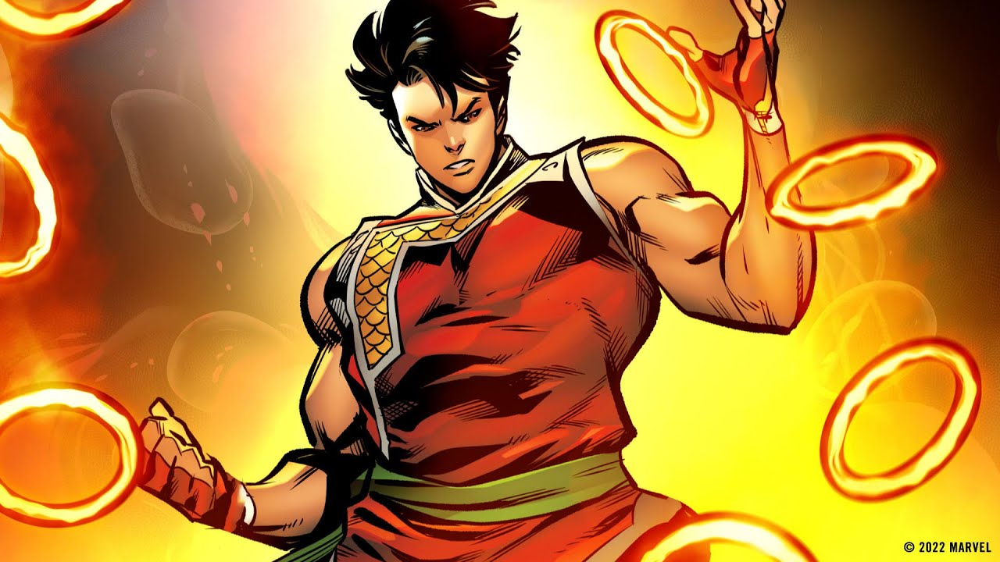

## Top 30 Superheroes Based on the number of Superpowers

In [76]:
sups['superpower_length'] = sups['superpowers'].apply(len)

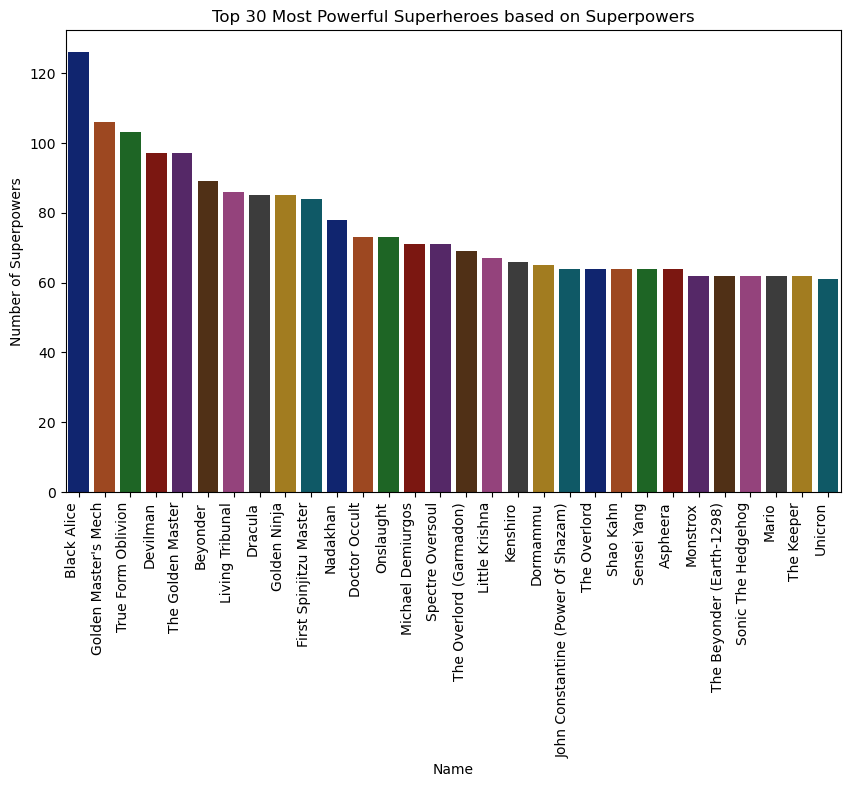

In [77]:
num_of_superpowers = sups.sort_values(by='superpower_length',ascending=False).nlargest(30,columns='superpower_length')

plt.figure(figsize=(10, 6))
sns.barplot(x='name', y='superpower_length', data=num_of_superpowers, palette='dark')
plt.xlabel('Name')
plt.ylabel('Number of Superpowers')
plt.title('Top 30 Most Powerful Superheroes based on Superpowers')
plt.xticks(rotation=90, ha='right')
plt.show()

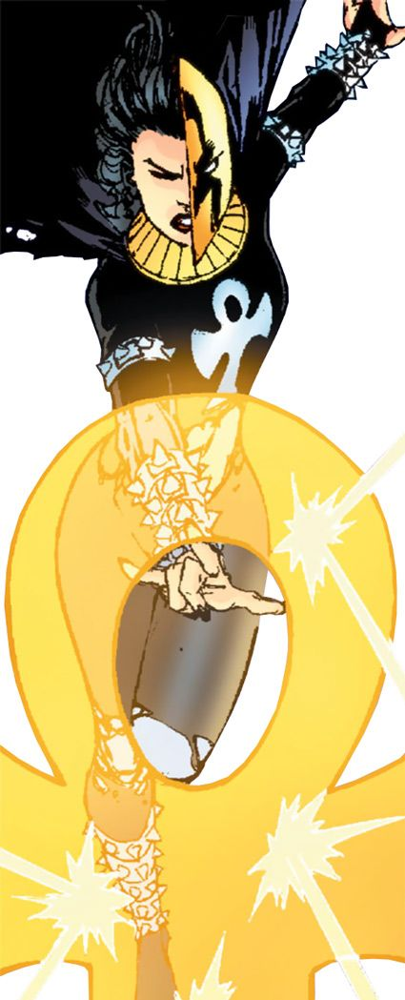

## Top 30 Superheroes with most number of Alter Egos

In [78]:
sups['alter_ego_length'] = sups['alter_egos'].apply(len)
#sups['alter_ego_length'].sort_values(ascending=False)

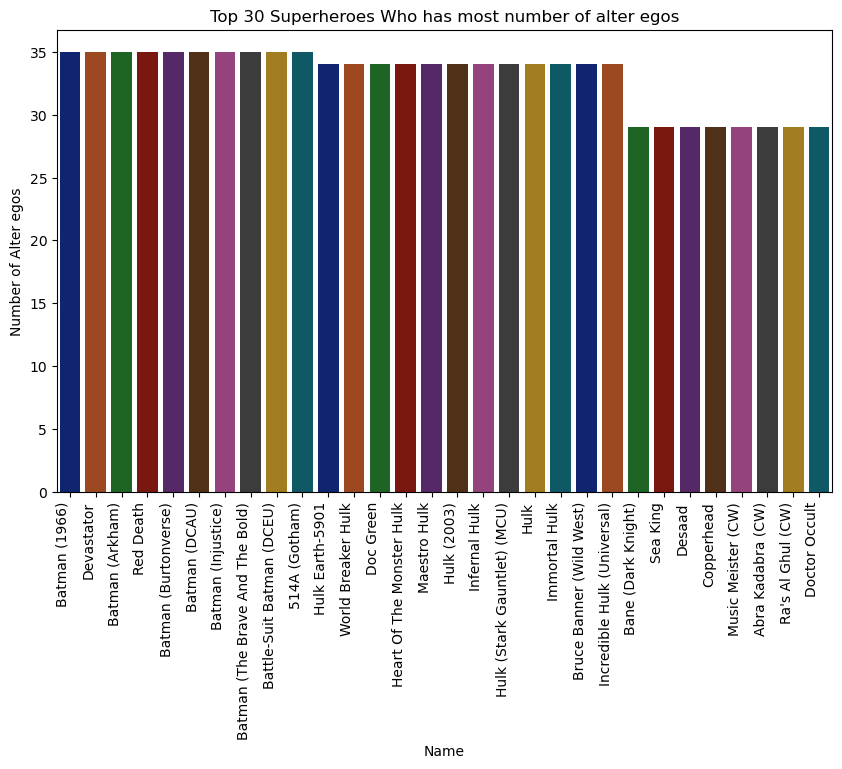

In [79]:
num_of_alter_egos = sups.sort_values(by='alter_ego_length',ascending=False).nlargest(30,columns='alter_ego_length')

plt.figure(figsize=(10, 6))
sns.barplot(x='name', y='alter_ego_length', data=num_of_alter_egos, palette='dark')
plt.xlabel('Name')
plt.ylabel('Number of Alter egos')
plt.title('Top 30 Superheroes Who has most number of alter egos')
plt.xticks(rotation=90, ha='right')
plt.show()

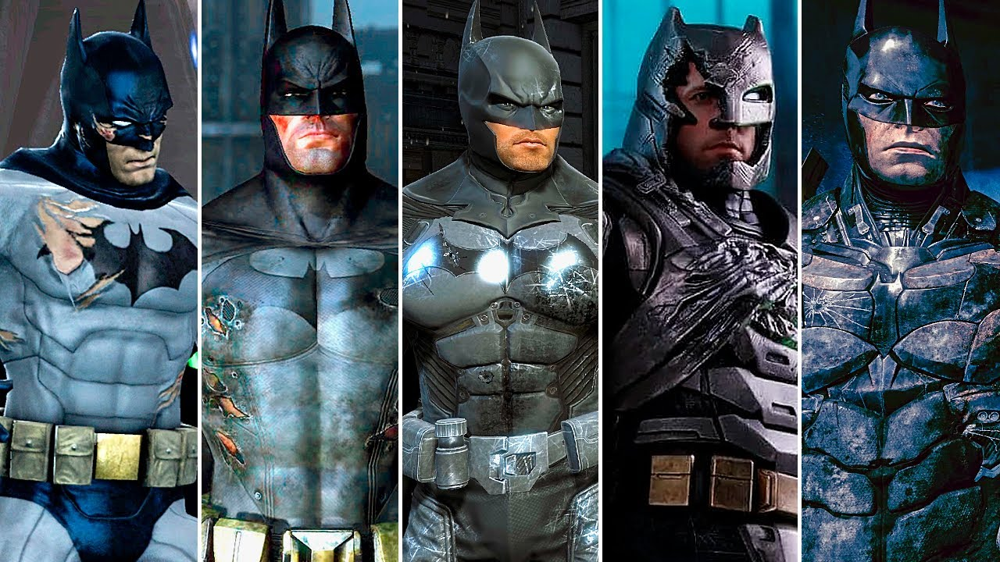

## Top 30 Superheroes who has the most number of aliases

In [81]:
sups['aliases_length'] = sups['aliases'].apply(len)

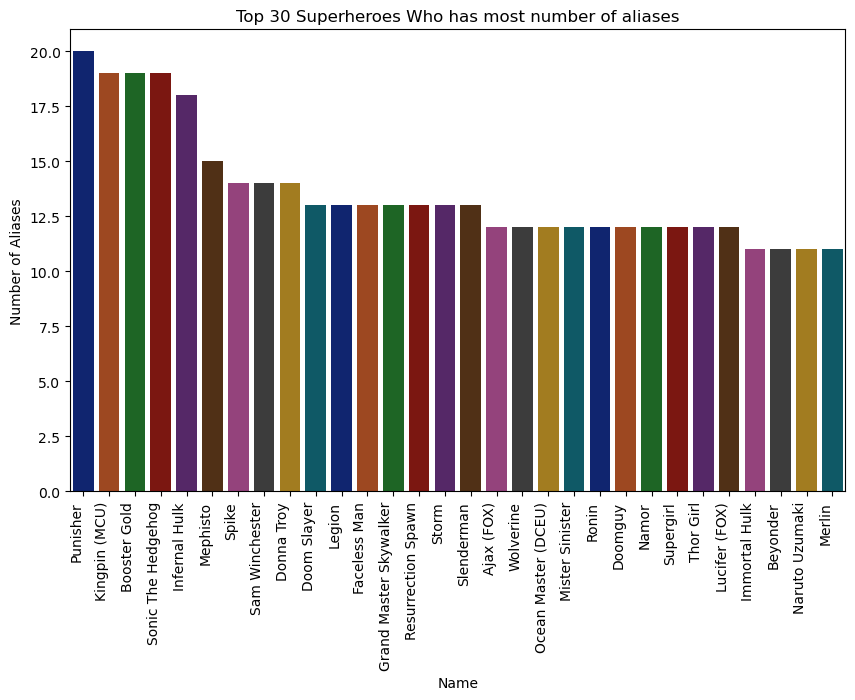

In [82]:
num_of_aliases = sups.sort_values(by='aliases_length',ascending=False).nlargest(30,columns='aliases_length')

plt.figure(figsize=(10, 6))
sns.barplot(x='name', y='aliases_length', data=num_of_aliases, palette='dark')
plt.xlabel('Name')
plt.ylabel('Number of Aliases')
plt.title('Top 30 Superheroes Who has most number of aliases')
plt.xticks(rotation=90, ha='right')
plt.show()

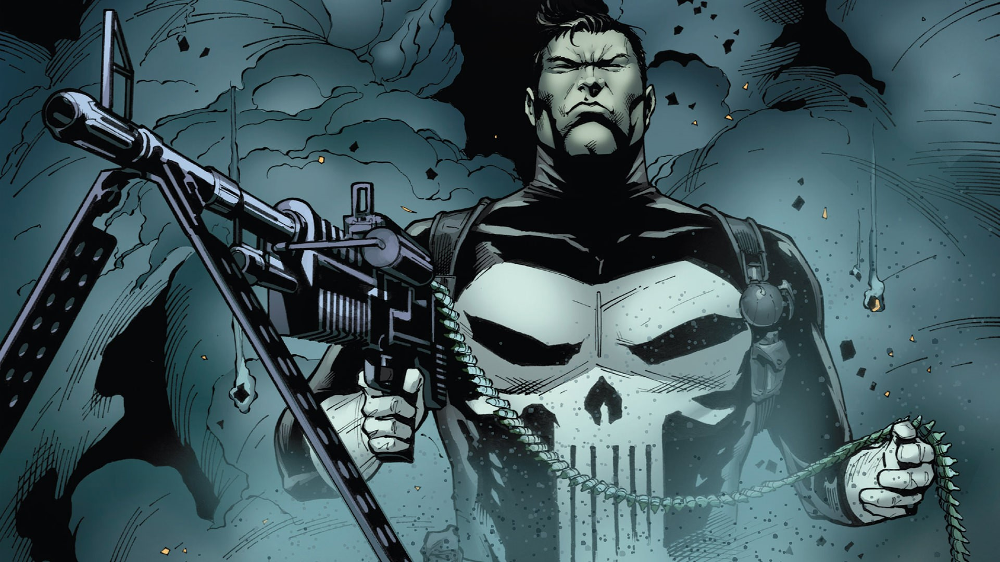

## Top 30 Places Superheroes Belongs to

In [104]:
group_sizes = sups['place_of_birth'].value_counts().nlargest(30)
size_list = group_sizes.tolist()

city_names = sups['place_of_birth'].value_counts().nlargest(30).index
city_list = city_names.tolist()

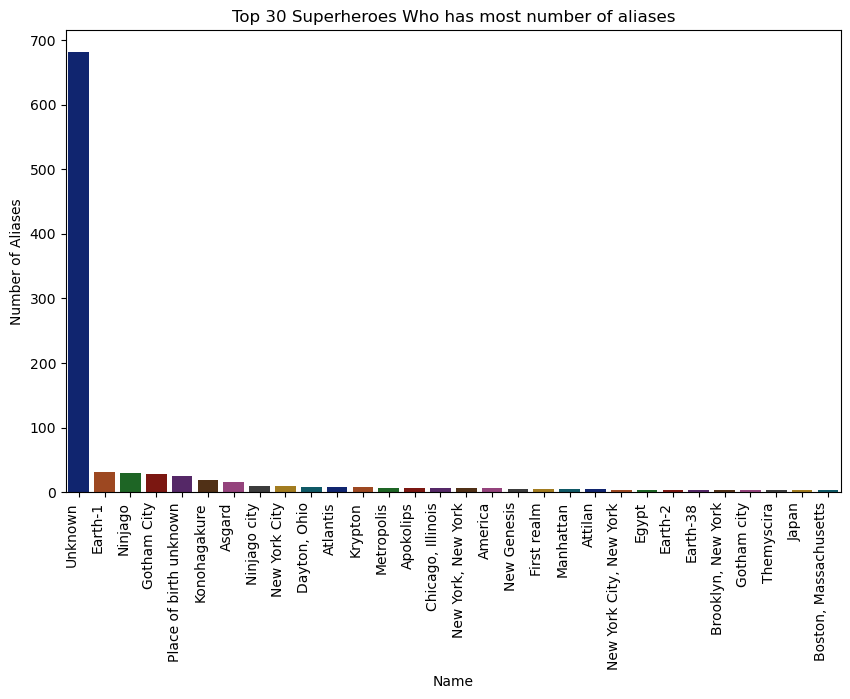

In [103]:
plt.figure(figsize=(10, 6))
sns.barplot(x=city_list, y=size_list, palette='dark')
plt.xlabel('Name')
plt.ylabel('Number of Aliases')
plt.title('Top 30 Superheroes Who has most number of aliases')
plt.xticks(rotation=90, ha='right')
plt.show()